# Koch Snowflake
The Koch snowflake (also known as the Koch curve, Koch star, or Koch island) is a fractal curve and one of the earliest fractals to have been described. It is based on the Koch curve, which appeared in a 1904 paper titled "On a Continuous Curve Without Tangents, Constructible from Elementary Geometry" by the Swedish mathematician Helge von Koch.

The Koch snowflake can be built up iteratively, in a sequence of stages. The first stage is an equilateral triangle, and each successive stage is formed by adding outward bends to each side of the previous stage, making smaller equilateral triangles. The areas enclosed by the successive stages in the construction of the snowflake converge to 8/5 times the area of the original triangle, while the perimeters of the successive stages increase without bound. Consequently, the snowflake encloses a finite area, but has an infinite perimeter.

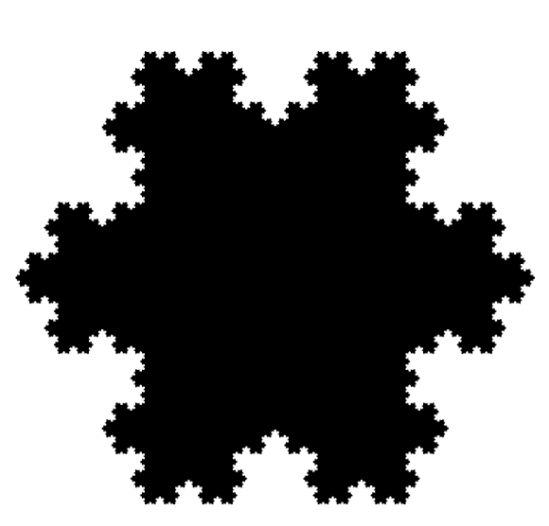

Inspired by a [video posted by @mathletters]('https://www.tiktok.com/@mathletters/video/7144078394383207723?is_from_webapp=1&sender_device=pc&web_id=7001436318157194758') I recreated the process in Python.

The steps are as follows

1. We start by drawing the six points of a hexagon
2. Our starting position is at point 1 (A)
3. We roll a dice which determins which corner is our target
4. We draw a point two thirds of the way between our starting point and the target corner
5. That new point is our new starting point
6. If we repeat this process 10,000 times we create a Koch Snowflake

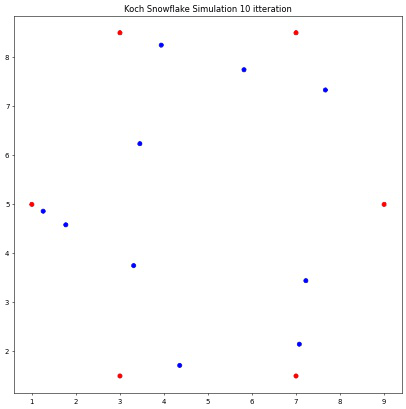

In [1]:
import random  # to generate random numbers

import gif  # to create the animated gif from our plots
import matplotlib.pyplot as plt  # to plot the points
import numpy as np
import math # Importing math library
from math import atan2, degrees, radians, cos, sin
from pathlib import Path
import imageio
import os
import re

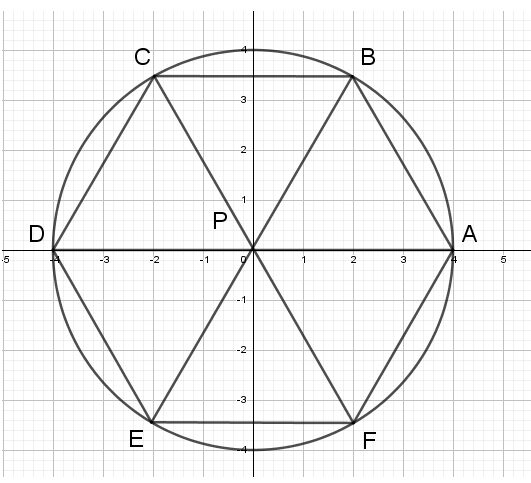

In [2]:
def calculate_new_point(start_point, end_point):

    # Case as numpy arrays
    start = np.array(start_point)
    end = np.array(end_point)

    # Centre start on zero to convert to polar coordinates
    new_end = end - start

    # Calculating radius
    radius = np.hypot(new_end[0], new_end[1])

    # Calculate 2 thirds of radius
    radius = (2 / 3) * radius

    # Calculating angle (theta)
    theta = np.degrees(np.arctan2(new_end[1], new_end[0]))

    # convert to radians
    theta = radians(theta)

    # Calculate x and y of new point (this is still polar)
    new_x = radius * cos(theta)
    new_y = radius * sin(theta)

    # Add to starting point to get new location
    new_x = start_point[0] + new_x
    new_y = start_point[1] + new_y

    # return the new x and y coordinates
    return [new_x, new_y]


In [3]:
def genearte_koch_snowflake(turns):
    # Frames to store images for animaged gif
    frames = []

    # Variable to store if it is first turn
    first_turn = True

    # Create the points for the 6 corners of the hexagon
    hex_1 = (9, 5)  # A
    hex_2 = (7, 8.5)  # B
    hex_3 = (3, 8.5)  # C
    hex_4 = (1, 5)  # D
    hex_5 = (3, 1.5)  # E
    hex_6 = (7, 1.5)  # F

    # Append the points to a list
    points = []
    points.append(hex_1)
    points.append(hex_2)
    points.append(hex_3)
    points.append(hex_4)
    points.append(hex_5)
    points.append(hex_6)

    # Dispaly the points and save as img
    # img = scatter_plot(points, 'Koch Snowflake Simulation')

    # Append the image to the frame (used to produce animated gif)
    # frames.append(img)

    # Start at point 1
    current_point = points[0]

    for i in range(turns):
        # randomly generate target point
        if first_turn == False:
            target_point = random.randint(1, 6)
        else:
            # First roll can't be 1
            target_point = random.randint(2, 6)
            first_turn = False
        # Calculate point 2/3 of the way between current and target
        new_point = calculate_new_point(current_point, points[target_point - 1])

        # Append point to the points list
        points.append(new_point)

        # Set current point to the point 2/3 of the way between current and target
        current_point = new_point
    # Return the points data
    return points


In [4]:
def delete_all_files_in_directory(path):
    [f.unlink() for f in Path(path).glob("*") if f.is_file()] 

In [134]:
def scatter_plot(data, title="", xlabel="", ylabel=""):
    # Declare lists to store the x and y points
    x = []
    y = []

    # Declare list to store filenames
    files = []

    # Declare array to store categories to colour the plot
    categories = np.empty(shape=0, dtype=np.int8)
    col = np.empty

    # use colormap to colour plot
    colormap = np.array(["r", "b"])

    # Delete any files from the temp folder
    delete_all_files_in_directory("temp/")

    # Setup the plot
    plt.figure(figsize=(10, 10))

    # set the x and y axis labels
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)

    # loop through each coordinate pair in the data
    for i in range(len(data)):
        # append the coordinates to the x and y list
        x.append(data[i][0])
        y.append(data[i][1])

        # Only save once 6 hexagon points have been added
        if i > 5:
            # Colour other points blue (category 1)
            categories = np.append(categories, 1)
            # set the plot title
            plt.title(f"{title} {i-5} itteration")
            # create the scatter plot with the x and y lists
            col = colormap[categories]

            # Save an image every 10 itterations (for first 1000) or 100 iterations for rest
            if ((i == 5) or (((i-5) <1000) and ((i-5) % 10 == 0)) or (((i-5) >=1000) and ((i-5) % 100 == 0))):
                plt.scatter(x, y, c=col)

                # Save an image of the plot
                filename = f"temp/Koch_snowflake_{i-5}.jpg"
                files.append(filename)
                plt.savefig(filename, bbox_inches="tight", dpi=50)
        else:
            # Colour 6 hexagon colours red (category 0)
            categories = np.append(categories, 0)


In [135]:
def create_gif(final_gif_name, images_directory):
    file_paths = []

    # Get all the filenames of the images
    for folder, subs, files in os.walk(images_directory):
        for filename in files:
            file_paths.append(os.path.abspath(os.path.join(folder, filename)))

    #Sort so numbers are sorted logicly
    file_paths = sorted(file_paths, key=lambda x:float(re.findall("(\d+)",x)[0]))
    
    # open the images and write them to the final gif
    with imageio.get_writer(final_gif_name, mode="I", duration=.075) as writer:
        for filename in file_paths:
            image = imageio.imread(filename)
            writer.append_data(image)
    # Delete any files from the temp folder
    delete_all_files_in_directory(images_directory)


In [26]:
def display_points(turns):
    # Generate the points
    points = genearte_koch_snowflake(turns)
    
    #Create the scatter plot and save the images
    scatter_plot(points, f'Koch Snowflake Simulation')

    #Create an animated gif of the images
    create_gif('Koch_snowflake.gif','temp')
    


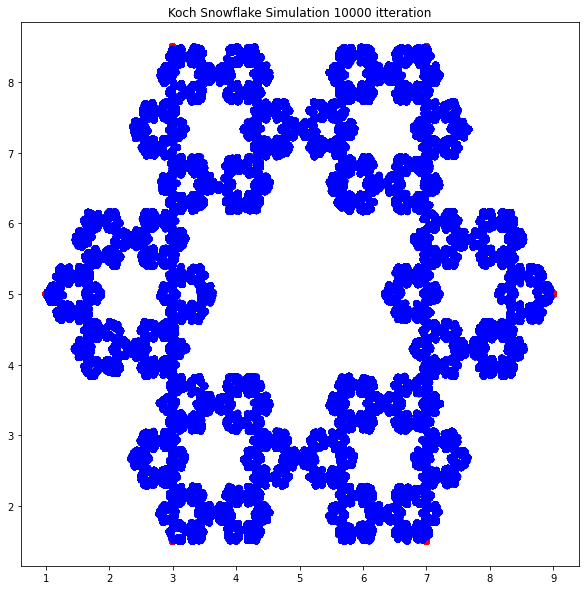

In [120]:
display_points(10_000)